# Visualizing astronomical* data 

### Francisco Förster Burón

### LSST Chile 2019
### 6 March



** * 1 billion rows!**








In [151]:
import pandas as pd
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

![](images/numpy.jpeg)
![](images/pandas.png)
![](images/matplotlib.png)

In [152]:
import datashader as ds
import datashader.transfer_functions as tf
import bokeh.plotting as bp
from datashader.bokeh_ext import InteractiveImage


![](images/bokeh.png)

![](images/ds.png)


In [153]:
import h5py    
from dask import dataframe as dd
from dask import array as da
import dask

![](images/HDF.png)
![](images/dask.png)

Ver https://github.com/bokeh/bokeh-notebooks/blob/master/tutorial/A2%20-%20Visualizing%20Big%20Data%20with%20Datashader.ipynb

1. Create random datapoints, 5 different Gaussian distributions with the parameters shown below

In [155]:
# random seed and number of points to plot
np.random.seed(1)
num=10000000

# the 5 different Gaussians using list comprehension to create dictionary
dists = {cat: pd.DataFrame(dict(x=np.random.normal(x,s,num),
                                y=np.random.normal(y,s,num),
                                val=val,cat=cat))
         for x,y,s,val,cat in 
         [(2,2,0.01,10,"d1"), (2,-2,0.1,20,"d2"), (-2,-2,0.5,30,"d3"), (-2,2,1.0,40,"d4"), (0,0,3,50,"d5")]}

In [156]:
dists.keys()

dict_keys(['d1', 'd2', 'd3', 'd4', 'd5'])

In [157]:
dists['d1'].tail()

,x,y,val,cat
9999995,2.001276,2.005102,10,d1
9999996,1.996526,2.002855,10,d1
9999997,1.998446,2.022901,10,d1
9999998,1.992940,2.003520,10,d1
9999999,1.993023,1.976634,10,d1


In [158]:
# concatenate dataframes
df = pd.concat(dists,ignore_index=True)
df["cat"] = df["cat"].astype("category")
df.sample(10)

,x,y,val,cat
7706363,2.010924,1.986810,10,d1
36918230,-3.705579,2.564537,40,d4
29204933,-1.811552,-1.722627,30,d3
6551713,2.001825,2.002917,10,d1
33301690,-1.930686,3.962942,40,d4
7320925,2.010379,1.990600,10,d1
26303465,-2.732311,-1.988080,30,d3
49931881,3.055298,-0.373809,50,d5
44237615,3.591443,-2.711374,50,d5
27026464,-2.474012,-1.420283,30,d3


# Matplotlib

2. Let's try to plot using matplotlib

CPU times: user 1.35 s, sys: 11.7 ms, total: 1.36 s
Wall time: 1.48 s


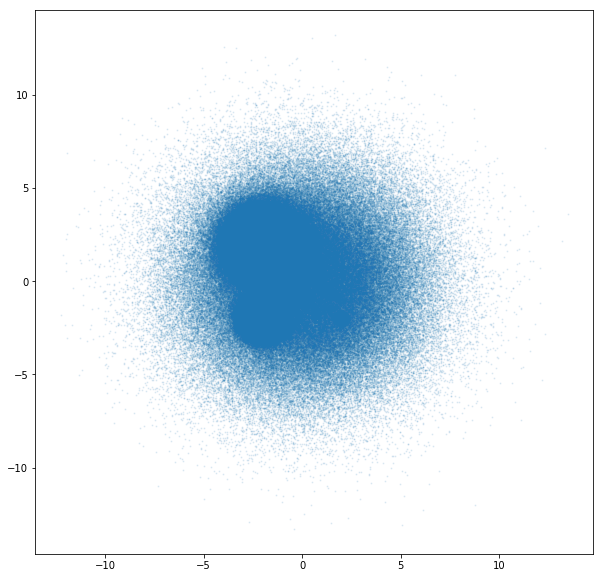

In [159]:
fig, ax = plt.subplots(figsize = (10, 10))
dfsamp = df.sample(1000000)
%time ax.scatter(dfsamp.x, dfsamp.y, alpha = 0.1, s = 1)

# Datashader

3. Let's try datashader instead

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


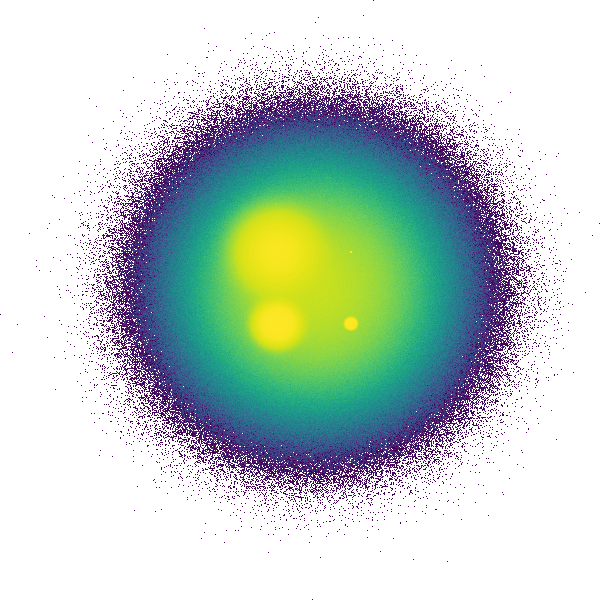

In [160]:
# Let's plot 50 M points!
tf.shade(ds.Canvas().points(df,'x','y'), cmap=plt.get_cmap('viridis'))

## Projection and Aggregation

The first stages of the datashader pipeline are to choose:

* which variables you want to plot on the x and y axes,
* what size array do you want to aggregate the values into,
* what range of data values should that array cover, and
* what "reduction" function you want to use for aggregating:

In [161]:
canvas = ds.Canvas(plot_width=250, plot_height=250, x_range=(-4,4), y_range=(-4,4))
agg = canvas.points(df, 'x', 'y', agg=ds.count())
agg

<xarray.DataArray (y: 250, x: 250)>
array([[27, 24, 30, ..., 29, 33, 27],
       [28, 44, 30, ..., 37, 27, 32],
       [24, 33, 34, ..., 33, 34, 26],
       ...,
       [73, 55, 64, ..., 35, 31, 27],
       [70, 65, 68, ..., 44, 31, 24],
       [67, 55, 61, ..., 20, 29, 36]], dtype=int32)
Coordinates:
  * y        (y) float64 -3.984 -3.952 -3.92 -3.888 ... 3.888 3.92 3.952 3.984
  * x        (x) float64 -3.984 -3.952 -3.92 -3.888 ... 3.888 3.92 3.952 3.984

## Transformations to projected & aggregated data

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


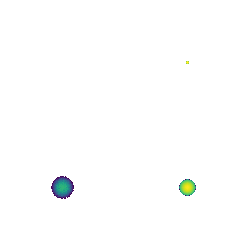

In [162]:
tf.shade(agg.where(agg>=np.percentile(agg,99)), cmap=plt.get_cmap('viridis'))

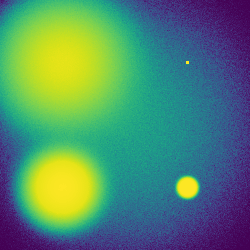

In [163]:
tf.shade(np.log(agg), cmap=plt.get_cmap('viridis'))

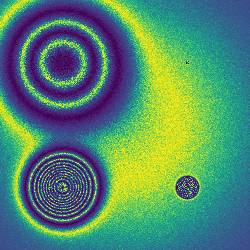

In [164]:
tf.shade(np.sin(agg/100), cmap=plt.get_cmap('viridis'))

## Different aggregation functions

In the previous example we have chosen to plot the 'x' and 'y' columns of the dataframe on the x and y axes (unsurprisingly!), and to aggregate them by `count`.  The result is a 2D [xarray](http://xarray.pydata.org/en/stable/computation.html) of the requested size, containing one value for each eventual pixel, counting the number of datapoints that were mapped to that pixel. An xarray is similar to a Numpy or Pandas data structure and supports similar operations, but allows arbitrary multidimensional data.

Available reduction functions that you could use for aggregating include:

**`count()`**: integer count of datapoints for each pixel (the default reduction).

**`any()`**: each pixel 1 if any datapoint maps to it; 0 otherwise.
  
**`sum(column)`**: total value of the given column for all datapoints in this pixel.

**`count_cat(column)`**: count datapoints _per category_ using the given categorical column (which must be declared using [Pandas' `categorical` datatype](https://pandas-docs.github.io/pandas-docs-travis/categorical.html)). 

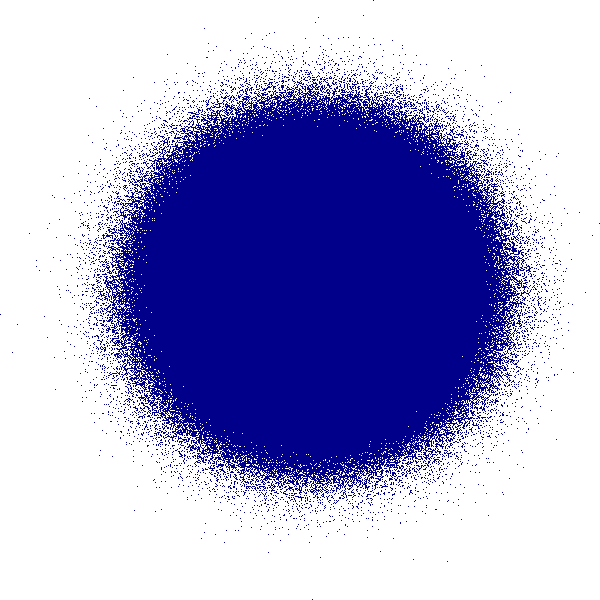

In [165]:
tf.shade(ds.Canvas().points(df,'x','y', agg=ds.any()))

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


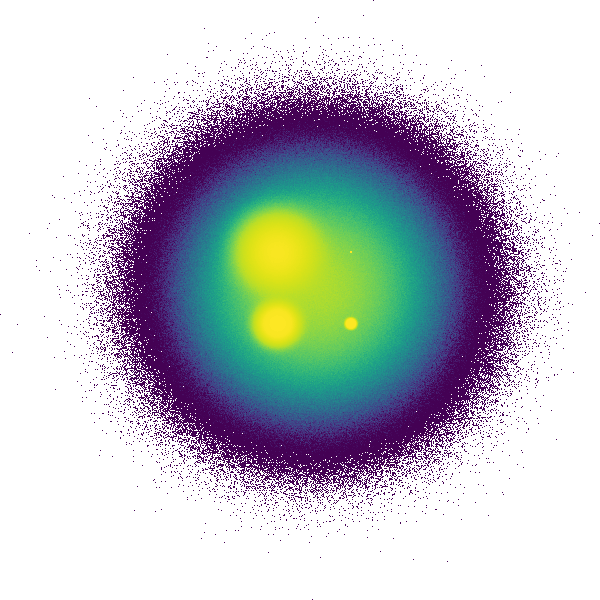

In [166]:
tf.shade(ds.Canvas().points(df,'x','y', agg=ds.sum('val')), cmap=plt.get_cmap('viridis'))

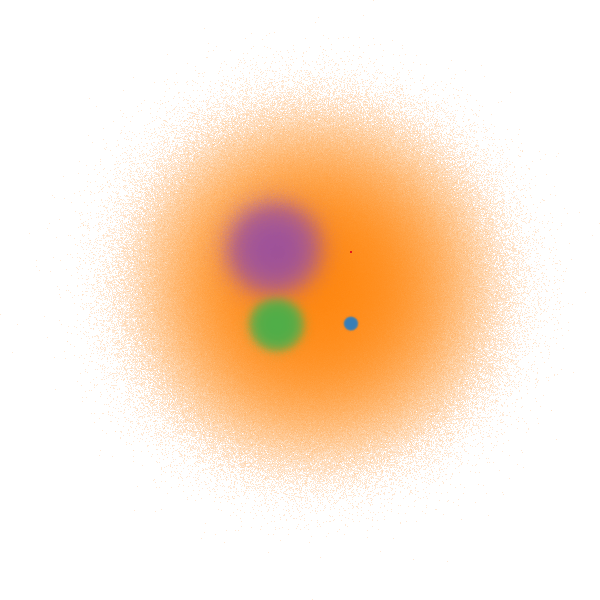

In [167]:
tf.shade(ds.Canvas().points(df,'x','y', agg=ds.count_cat('cat')))

## Colormaps

4. Let's play with the color maps

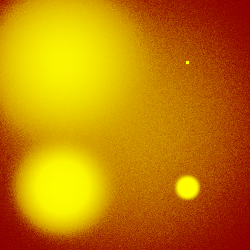

In [168]:
tf.shade(agg, cmap=["darkred", "yellow"])

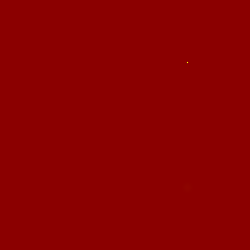

In [169]:
tf.shade(agg,cmap=["darkred", "yellow"],how='linear')

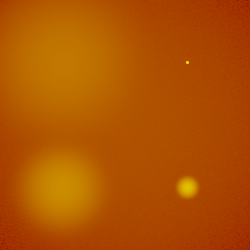

In [170]:
tf.shade(agg,cmap=["darkred", "yellow"],how='log')

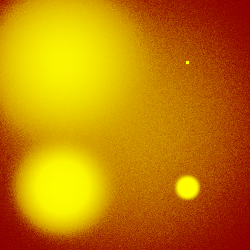

In [171]:
tf.shade(agg,cmap=["darkred", "yellow"],how='eq_hist')

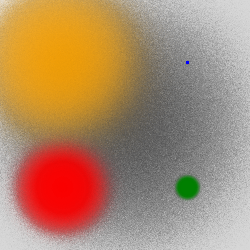

In [172]:
color_key = {'d1':'blue', 'd2':'green', 'd3':'red', 'd4':'orange', 'd5':'black'}
aggc = canvas.points(df, 'x', 'y', ds.count_cat('cat'))
tf.shade(aggc, color_key=color_key)

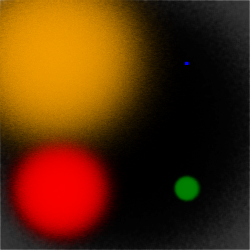

In [173]:
tf.spread(tf.shade(aggc, color_key=color_key))

## Bokeh + datashader

5. Let's embed datashader plot into bokeh

In [174]:
bp.output_notebook()
p = bp.figure(tools='pan,save, box_zoom,wheel_zoom,reset', x_range=(-5,5), y_range=(-5,5))

def image_callback(x_range, y_range, w, h):
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.points(df, 'x', 'y', ds.count_cat('cat'))
    img = tf.shade(agg, color_key=color_key)
    return tf.dynspread(img, threshold=0.25)

InteractiveImage(p, image_callback)

Loading BokehJS ...

# Load dataframes

## ZTF
![](images/ZTF1.png)
![](images/ZTF2.jpg)

https://www.dropbox.com/s/hc4mfclyvqdeu7z/ZTF.pickle?dl=0

In [214]:
ZTF = pickle.load(open("ZTF.pickle", "rb"))
print(ZTF.count())
ZTF.head()

ra     14543166
dec    14543166
dtype: int64


,ra,dec
idZTF,,
ZTF17aaaaaal,59.899031,50.278119
ZTF17aaaaaam,60.275177,49.811788
ZTF17aaaaaan,64.334160,45.594245
ZTF17aaaaaao,63.989748,45.430481
ZTF17aaaaaas,68.578088,49.087101


## CRTS
![](images/CRTS.jpg)
![](images/CRTS2.jpeg)

https://www.dropbox.com/s/7n7ytd34ovm311f/CRTSnorth.pickle?dl=0

In [148]:
CRTSnorth = pickle.load(open("CRTSnorth.pickle", "rb"))
CRTSnorth.head()

,mag_V,period_days,class,ra,dec
idCRTSnorth,,,,,
CSS_J000020.4+103118,14.62,1.491758,2,0.085042,10.521917
CSS_J000031.5-084652,14.14,0.404185,1,0.131250,-8.781194
CSS_J000036.9+412805,17.39,0.274627,1,0.153917,41.468250
CSS_J000037.5+390308,17.74,0.30691,1,0.156458,39.052250
CSS_J000103.3+105724,15.25,1.5837582,8,0.264042,10.956778


## ATLAS
![](images/ATLAS1.jpg)
![](images/ATLAS2.png)

https://www.dropbox.com/s/owdzrh4tui117wy/ATLAS_all.pickle?dl=0

https://www.dropbox.com/s/6k8ni73ypr7z6xu/ATLAS_nondubious.pickle?dl=0

In [149]:
ATLAS_all = pickle.load(open("ATLAS_all.pickle", "rb"))
ATLAS_all.head()

,ra,dec,period_days,class,mag_c,mag_o
idATLASDR1,,,,,,
J111.2911+05.6850,111.29110,5.68502,0.997641,dubious,16.334,15.958
J288.7631-04.5566,288.76310,-4.55662,0.773113,dubious,16.369,15.623
J356.9276-01.6548,356.92764,-1.65480,0.152285,dubious,16.431,15.733
J283.0037-06.5376,283.00372,-6.53762,0.993957,dubious,15.393,14.269
J288.3295-04.1938,288.32952,-4.19387,731.137207,dubious,15.855,15.137


In [150]:
ATLAS_nondubious = pickle.load(open("ATLAS_nondubious.pickle", "rb"))
ATLAS_nondubious.head()

,ra,dec,period_days,class,mag_c,mag_o
idATLASDR1,,,,,,
J015.2434+59.4872,15.24345,59.48721,47.181004,LPV,14.871,14.035
J294.5913+33.6224,294.59135,33.62249,370.874329,LPV,16.081,15.855
J083.6853+53.7244,83.68530,53.72442,0.249233,LPV,15.893,15.563
J025.0711-00.8341,25.07112,-0.83417,0.998363,LPV,16.261,16.265
J028.0902+56.3283,28.09026,56.32834,11.321711,IRR,14.264,13.981


### Do Aitoff projections

In [ ]:
import aitoff as at

In [181]:
lz = 180
def add_aitoff(df):
    radec = SkyCoord(ra = np.array(df.ra) * u.degree, dec = np.array(df.dec) * u.degree)
    df["aitoff_x"], df["aitoff_y"] = at.project(np.array(radec.ra), np.array(radec.dec), lz)
for df in [ZTF, CRTSnorth, ATLAS_all, ATLAS_nondubious]:
    add_aitoff(df)

In [183]:
ATLAS_all['cat'] = 'ATLAS_all'
ATLAS_nondubious['cat'] = 'ATLAS_nondubious'
ZTF['cat'] = 'ZTF'
CRTSnorth['cat'] = 'CRTSnorth'

In [184]:
df1 = ATLAS_all[['ra', 'dec', 'aitoff_x', 'aitoff_y', 'cat']]
df2 = ZTF[['ra', 'dec', 'aitoff_x', 'aitoff_y', 'cat']]
df3 = CRTSnorth[['ra', 'dec', 'aitoff_x', 'aitoff_y', 'cat']]
dfall = pd.concat([df1, df2, df3], ignore_index=True)
dfall["cat"] = dfall["cat"].astype("category")

In [185]:
dfall.sample(10)

,ra,dec,aitoff_x,aitoff_y,cat
3129428,311.525240,7.828570,137.097961,10.335956,ATLAS_all
9214208,26.065616,54.632757,-95.463666,69.024601,ZTF
16392459,86.608366,35.024624,-85.837765,41.333907,ZTF
18153347,153.469981,-19.733125,-28.084806,-21.952284,ZTF
17444092,37.930976,51.592175,-96.464363,64.328925,ZTF
2201738,271.753220,14.802680,96.578912,17.776946,ATLAS_all
12639120,283.208186,-5.347620,110.409784,-6.593383,ZTF
15234673,105.683052,34.928316,-69.323312,40.074360,ZTF
9645141,299.744074,26.908030,115.386283,33.852869,ZTF
8135171,323.224087,44.171197,110.636471,56.632053,ZTF


In [186]:
bp.output_notebook()
p = bp.figure(tools='pan,wheel_zoom,reset', x_range=(0,360), y_range=(-90,90), plot_width=800, plot_height=500)
color_key = {'ATLAS_all': 'blue', 'ZTF': 'red', 'CRTSnorth': 'green'}

def image_callback(x_range, y_range, w, h):
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.points(dfall, 'ra', 'dec', ds.count_cat('cat'))
    img = tf.shade(agg, color_key=color_key)
    return tf.dynspread(img, threshold=0.25)

InteractiveImage(p, image_callback)

Loading BokehJS ...

## Try Aitoff projection

In [187]:
p = bp.figure(tools='pan,wheel_zoom,reset', x_range=(-180,180), y_range=(-90,90), plot_width=800, plot_height=500)

def image_callback(x_range, y_range, w, h):
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.points(dfall, 'aitoff_x', 'aitoff_y', ds.count_cat('cat'))
    img = tf.shade(agg, color_key=color_key)
    return tf.dynspread(img, threshold=0.25)

InteractiveImage(p, image_callback)

## Grid lines

In [188]:
import aitoff as at
def dogrid(lz, npts = 1000):
    decx = np.array([i * 36 * np.ones(npts) for i in range(11)]).flatten()
    decy = np.array([(-1)**i * np.linspace(-90, 90, npts) for i in range(11)]).flatten()
    rax = np.array([np.linspace(0, 360, npts)[::(-1)**i] for i in range(13)]).flatten()
    ray = np.array([(-90 + i * 15) * np.ones(npts) for i in range(13)]).flatten()
    dfdeclines = pd.DataFrame({'ra': decx, 'dec': decy})
    dfralines = pd.DataFrame({'ra': rax[::-1], 'dec': ray[::-1]})
    grid = pd.concat([dfdeclines, dfralines], ignore_index = True)
    grid["aitoff_x"], grid["aitoff_y"] = at.project(np.array(grid.ra), np.array(grid.dec), lz)
    return grid

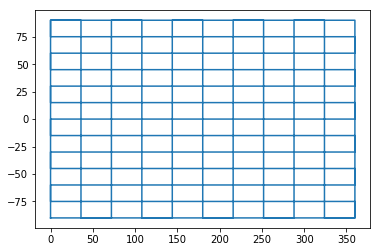

In [189]:
grid = dogrid(lz)
fig, ax = plt.subplots()
ax.plot(grid.ra, grid.dec);

In [191]:
x_range=(-180,180)
y_range=(-90,90)
plot_width=800
plot_height=500

color_key = {'ATLAS_all': 'blue', 'ZTF': 'red', 'CRTSnorth': 'green'}#, 'grid': 'black'}

def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(dfall, 'aitoff_x', 'aitoff_y', agg=ds.count_cat('cat'))
    im1 = cvs.line(grid, 'aitoff_x', 'aitoff_y', agg=ds.any())
    #imgs = [tf.shade(im0, color_key=color_key), tf.shade(im1, cmap="black")]
    im2 = cvs.points(dfall[dfall.cat == 'CRTSnorth'], 'aitoff_x', 'aitoff_y', agg=ds.count())
    imgs = [tf.spread(tf.shade(im2, cmap="green")), tf.shade(im0, color_key=color_key), tf.shade(im1, cmap="black")]
    agg = tf.stack(*imgs)
    return tf.dynspread(agg, threshold=0.25)

def base_plot(tools='pan,wheel_zoom,reset', **plot_args):
    p = bp.figure(tools=tools, plot_width=plot_width, plot_height=plot_height,
        x_range=x_range, y_range=y_range, outline_line_color=None,
        min_border=0, min_border_left=0, min_border_right=0,
        min_border_top=0, min_border_bottom=0)   
    p.axis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    return p


p = base_plot()
InteractiveImage(p, create_image)

### Plot the mean magnitude of the objects in ATLAS

In [192]:
list(ATLAS_all)

['ra',
 'dec',
 'period_days',
 'class',
 'mag_c',
 'mag_o',
 'aitoff_x',
 'aitoff_y',
 'cat']

In [196]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(ATLAS_all, 'aitoff_x', 'aitoff_y', agg=ds.reductions.mean('mag_c'))
    im1 = cvs.line(grid, 'aitoff_x', 'aitoff_y', agg=ds.any())
    imgs = [tf.shade(im0, cmap=plt.get_cmap('viridis')), tf.shade(im1, cmap="black")]
    agg = tf.stack(*imgs)
    return tf.dynspread(agg, threshold=0.25)


p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


In [197]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(ATLAS_all, 'aitoff_x', 'aitoff_y', agg=ds.reductions.mean('mag_o'))
    im1 = cvs.line(grid, 'aitoff_x', 'aitoff_y', agg=ds.any())
    imgs = [tf.shade(im0, cmap=plt.get_cmap('viridis')), tf.shade(im1, cmap="black")]
    agg = tf.stack(*imgs)
    return tf.dynspread(agg, threshold=0.25)


p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


* *cyan* filter : 420–650 nm
* *orange* filter: 560–820 nm

### Plot the distribution of periods in CRTS

In [198]:
list(CRTSnorth)

['mag_V', 'period_days', 'class', 'ra', 'dec', 'aitoff_x', 'aitoff_y', 'cat']

In [205]:
CRTSnorth["period_days"] = pd.to_numeric(CRTSnorth["period_days"], errors='coerce')

def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(CRTSnorth, 'aitoff_x', 'aitoff_y', agg=ds.reductions.mean('class'))
    im1 = cvs.line(grid, 'aitoff_x', 'aitoff_y', agg=ds.any())
    imgs = [tf.spread(tf.shade(im0, cmap=plt.get_cmap('viridis'))), tf.shade(im1, cmap="black")]
    agg = tf.stack(*imgs)
    return tf.dynspread(agg, threshold=0.25)


p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


In [206]:
CRTSnorth['class'] = CRTSnorth['class'].astype("category")

In [213]:
CRTSnorth["class"].unique()

[2, 1, 8, 3, 5, ..., 7, 9, 11, 15, 12]
Length: 17
Categories (17, int64): [2, 1, 8, 3, ..., 9, 11, 15, 12]

In [209]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(CRTSnorth[CRTSnorth.class = '', 'aitoff_x', 'aitoff_y', agg=ds.count_cat('class'))
    im1 = cvs.line(grid, 'aitoff_x', 'aitoff_y', agg=ds.any())
    imgs = [tf.spread(tf.shade(im0, cmap=plt.get_cmap('viridis'))), tf.shade(im1, cmap="black")]
    agg = tf.stack(*imgs)
    return tf.dynspread(agg, threshold=0.25)


p = base_plot()
InteractiveImage(p, create_image)




## Restart the kernel...





![](images/GAIA.jpg)

# Load 10% GAIA catalog (~115,000,000 stars)

In [4]:
GAIAh5file = "/home/fforster/DATA_nodropbox/GAIA/gaia-dr1-10percent.hdf5"

In [5]:
GAIA = h5py.File(GAIAh5file)

In [6]:
list(GAIA['data'])

['astrometric_delta_q',
 'astrometric_excess_noise',
 'astrometric_excess_noise_sig',
 'astrometric_n_bad_obs_ac',
 'astrometric_n_bad_obs_al',
 'astrometric_n_good_obs_ac',
 'astrometric_n_good_obs_al',
 'astrometric_n_obs_ac',
 'astrometric_n_obs_al',
 'astrometric_primary_flag',
 'astrometric_priors_used',
 'astrometric_relegation_factor',
 'astrometric_weight_ac',
 'astrometric_weight_al',
 'b',
 'dec',
 'dec_error',
 'dec_parallax_corr',
 'dec_pmdec_corr',
 'dec_pmra_corr',
 'duplicated_source',
 'ecl_lat',
 'ecl_lon',
 'l',
 'matched_observations',
 'parallax',
 'parallax_error',
 'parallax_pmdec_corr',
 'parallax_pmra_corr',
 'phot_g_mean_flux',
 'phot_g_mean_flux_error',
 'phot_g_mean_mag',
 'phot_g_n_obs',
 'phot_variable_flag',
 'pmdec',
 'pmdec_error',
 'pmra',
 'pmra_error',
 'pmra_pmdec_corr',
 'ra',
 'ra_dec_corr',
 'ra_error',
 'ra_parallax_corr',
 'ra_pmdec_corr',
 'ra_pmra_corr',
 'random_index',
 'random_index_new',
 'ref_epoch',
 'scan_direction_mean_k1',
 'scan_dire

In [7]:
GAIAdf = pd.DataFrame({'ra': np.array(GAIA['data']['ra']), \
                       'dec': np.array(GAIA['data']['dec']), \
                       'phot_g_mean_mag': np.array(GAIA['data']['phot_g_mean_mag']), \
                       'parallax': np.array(GAIA['data']['parallax'])})

In [8]:
len(GAIAdf)

114267977

In [9]:
x_range=(0,360)
y_range=(-90,90)
plot_width=800
plot_height=500

def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(GAIAdf, 'ra', 'dec', agg=ds.count())
    return tf.shade(im0, cmap=plt.get_cmap('viridis'))

def base_plot(tools='pan,box_zoom,reset', **plot_args):
    p = bp.figure(tools=tools, plot_width=plot_width, plot_height=plot_height,
        x_range=x_range, y_range=y_range, outline_line_color=None,
        min_border=0, min_border_left=0, min_border_right=0,
        min_border_top=0, min_border_bottom=0)   
    p.axis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    return p


p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


In [10]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(GAIAdf, 'ra', 'dec', ds.reductions.mean('phot_g_mean_mag'))
    return tf.shade(im0, cmap=plt.get_cmap('viridis'))

p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


In [12]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(GAIAdf, 'ra', 'dec', ds.reductions.mean('parallax'))
    return tf.spread(tf.shade(im0, cmap=plt.get_cmap('viridis')))

p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1





## Restart the kernel...





# Load 100% GAIA catalog (~1,150,000,000 stars)

In [21]:
GAIAh5file = "/home/fforster/DATA_nodropbox/GAIA/gaia-dr1-minimal.hdf5"

In [22]:
GAIA = h5py.File(GAIAh5file)

In [23]:
list(GAIA['data'])

['astrometric_excess_noise',
 'b',
 'dec',
 'l',
 'matched_observations',
 'phot_g_mean_flux',
 'phot_g_mean_flux_error',
 'phot_g_mean_mag',
 'ra',
 'random_index',
 'source_id']

In [24]:
GAIAdf = pd.DataFrame({'ra': np.array(GAIA['data']['ra']), \
                       'dec': np.array(GAIA['data']['dec']), \
                       'phot_g_mean_mag': np.array(GAIA['data']['phot_g_mean_mag'])})

In [25]:
len(GAIAdf)

1142679769

### Don't do this

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


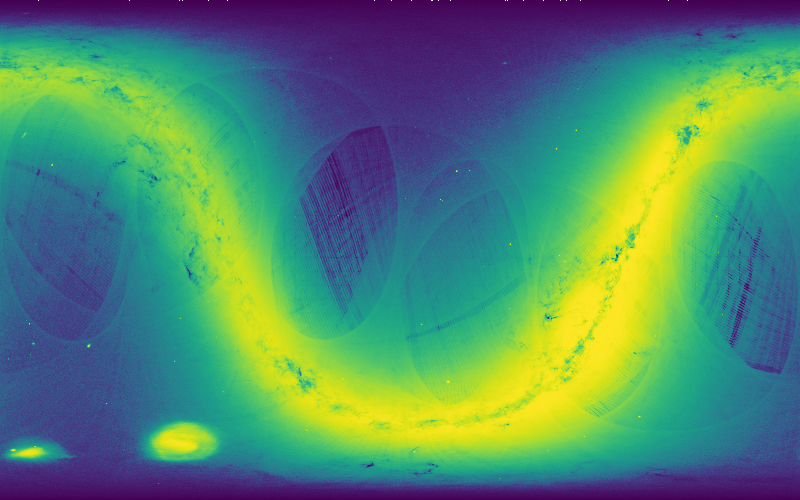

In [26]:
tf.shade(ds.Canvas(plot_width=800, plot_height=500).points(GAIAdf,'ra','dec', ), cmap=plt.get_cmap("viridis"))

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


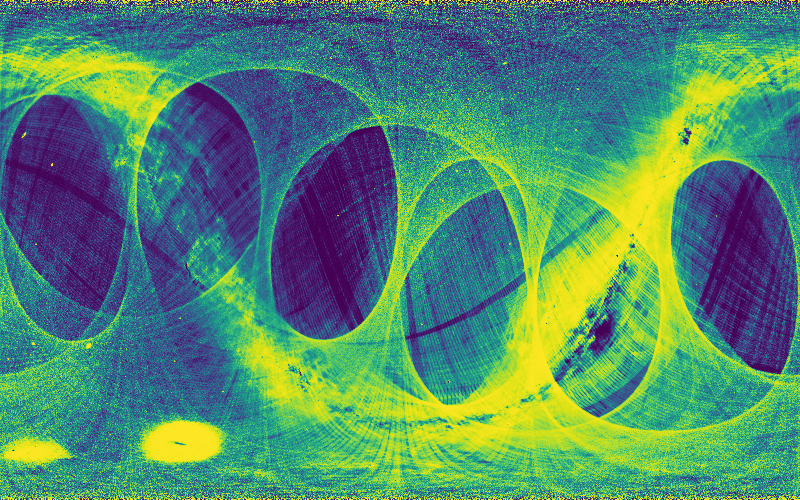

In [27]:
tf.shade(ds.Canvas(plot_width=800, plot_height=500).\
         points(GAIAdf,'ra','dec', agg=ds.reductions.mean('phot_g_mean_mag')), cmap=plt.get_cmap("viridis"))

# Load 10% GAIA using Dask

In [4]:
GAIAh5file = "/home/fforster/DATA_nodropbox/GAIA/gaia-dr1-10percent.hdf5"

In [5]:
GAIA = h5py.File(GAIAh5file)

In [6]:
list(GAIA['data'])

['astrometric_delta_q',
 'astrometric_excess_noise',
 'astrometric_excess_noise_sig',
 'astrometric_n_bad_obs_ac',
 'astrometric_n_bad_obs_al',
 'astrometric_n_good_obs_ac',
 'astrometric_n_good_obs_al',
 'astrometric_n_obs_ac',
 'astrometric_n_obs_al',
 'astrometric_primary_flag',
 'astrometric_priors_used',
 'astrometric_relegation_factor',
 'astrometric_weight_ac',
 'astrometric_weight_al',
 'b',
 'dec',
 'dec_error',
 'dec_parallax_corr',
 'dec_pmdec_corr',
 'dec_pmra_corr',
 'duplicated_source',
 'ecl_lat',
 'ecl_lon',
 'l',
 'matched_observations',
 'parallax',
 'parallax_error',
 'parallax_pmdec_corr',
 'parallax_pmra_corr',
 'phot_g_mean_flux',
 'phot_g_mean_flux_error',
 'phot_g_mean_mag',
 'phot_g_n_obs',
 'phot_variable_flag',
 'pmdec',
 'pmdec_error',
 'pmra',
 'pmra_error',
 'pmra_pmdec_corr',
 'ra',
 'ra_dec_corr',
 'ra_error',
 'ra_parallax_corr',
 'ra_pmdec_corr',
 'ra_pmra_corr',
 'random_index',
 'random_index_new',
 'ref_epoch',
 'scan_direction_mean_k1',
 'scan_dire

In [7]:
dd_ra = dd.from_dask_array(da.from_array(GAIA["data/ra"], chunks = 50000000))
dd_dec = dd.from_dask_array(da.from_array(GAIA["data/dec"], chunks = 50000000))
dd_g = dd.from_dask_array(da.from_array(GAIA["data/phot_g_mean_mag"], chunks = 50000000))

In [8]:
GAIAdf = dd.concat([dd_ra, dd_dec, dd_g], axis = 1)
GAIAdf.columns = ['ra', 'dec', 'g']
GAIAdf.head()

,ra,dec,g
0,70.448328,-71.695749,20.217213
1,74.410435,-10.098081,19.332070
2,258.985589,-27.882418,19.577874
3,229.907911,-42.875560,18.785776
4,241.598657,-43.422118,18.026915


In [9]:
GAIAdf

,ra,dec,g
npartitions=3,,,
0,float64,float64,float64
50000000,...,...,...
100000000,...,...,...
114267976,...,...,...


In [10]:
x_range=(0,360)
y_range=(-90,90)
plot_width=800
plot_height=500

def base_plot(tools='pan,box_zoom,reset', **plot_args):
    p = bp.figure(tools=tools, plot_width=plot_width, plot_height=plot_height,
        x_range=x_range, y_range=y_range, outline_line_color=None,
        min_border=0, min_border_left=0, min_border_right=0,
        min_border_top=0, min_border_bottom=0)   
    p.axis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    return p

In [11]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    im0 = cvs.points(GAIAdf, 'ra', 'dec', agg=ds.count())
    return tf.shade(im0, cmap=plt.get_cmap('viridis'))

p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


# Load 100% GAIA using Dask

In [21]:
GAIAh5file = "/home/fforster/DATA_nodropbox/GAIA/gaia-dr1-minimal.hdf5"

In [22]:
GAIA = h5py.File(GAIAh5file)

In [23]:
list(GAIA['data'])

['astrometric_excess_noise',
 'b',
 'dec',
 'l',
 'matched_observations',
 'phot_g_mean_flux',
 'phot_g_mean_flux_error',
 'phot_g_mean_mag',
 'ra',
 'random_index',
 'source_id']

In [24]:
dd_ra = dd.from_dask_array(da.from_array(GAIA["data/ra"], chunks = 70000000))
dd_dec = dd.from_dask_array(da.from_array(GAIA["data/dec"], chunks = 70000000))
dd_g = dd.from_dask_array(da.from_array(GAIA["data/phot_g_mean_mag"], chunks = 70000000))

In [25]:
GAIAdf = dd.concat([dd_ra, dd_dec, dd_g], axis = 1)
GAIAdf.columns = ['ra', 'dec', 'g']
GAIAdf.head()

,ra,dec,g
0,70.448328,-71.695749,20.217213
1,74.410435,-10.098081,19.332070
2,258.985589,-27.882418,19.577874
3,229.907911,-42.875560,18.785776
4,241.598657,-43.422118,18.026915


In [26]:
GAIAdf

,ra,dec,g
npartitions=17,,,
0,float64,float64,float64
70000000,...,...,...
...,...,...,...
1120000000,...,...,...
1142679768,...,...,...


In [27]:
x_range=(0,360)
y_range=(-90,90)
plot_width=800
plot_height=500

def base_plot(tools='pan,save,box_zoom,reset', **plot_args):
    p = bp.figure(tools=tools, plot_width=plot_width, plot_height=plot_height,
        x_range=x_range, y_range=y_range, outline_line_color=None,
        min_border=0, min_border_left=0, min_border_right=0,
        min_border_top=0, min_border_bottom=0)   
    p.axis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    return p

In [28]:
def create_image(x_range=x_range, y_range=y_range, w=500, h=500):
    cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=h, plot_width=w)
    agg = None
    for i in range(GAIAdf.npartitions):
        print("Partition :%i" % i, end = "\r")
        if agg is None:
            agg = cvs.points(GAIAdf.get_partition(i),'ra','dec')
        else:
            agg += cvs.points(GAIAdf.get_partition(i),'ra','dec')
    return tf.shade(agg, cmap=plt.get_cmap('viridis'))

p = base_plot()
InteractiveImage(p, create_image)

/home/fforster/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
